<a href="https://colab.research.google.com/github/chm10/MO443/blob/master/projeto2/Trabalho_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Nome:**Christian Hideki Maekawa  - **RA:** 231867

# Introdução
O objetivo deste trabalho é aplicar técnicas de meios-tons que visem reduzir a quantidade de cores (quantização de cores) utilizada para exibir um imagem enquanto matém a percepção visual. Este trabalho deve implementar um código para alterar os níveis de cinza [fmin...fmax] de uma imagem f(x, y) por meio das técnicas de meios-tons com difusão de erro, produzindo uma imagem g(x, y). Técnicas de pontilhado com difusão de erro procuram distribuir a diferença entre o valor exato de cada pixel e seu valor aproximado a um conjunto de pixels adjacentes.


# O Programa
O programa foi implementado usando ubuntu 18.04.5 LTS e python 3.6.9. As bibliotecas utilizadas para este trabalho foram numpy 1.18.5, matplotlib 3.2.2, opencv python 4.1.2.30. e pathlib 1.0.1.

A seguir coloquei os comandos para mostrar as configuração do ambiente.

In [ ]:
!lsb_release -d

Description:	Ubuntu 18.04.5 LTS


In [ ]:
!python --version

Python 3.6.9


## Como executar
O programa foi desenvolvido para ser executado com o ambiente Colab. Para executar a célula é necessário pressionar `Shift` + `Enter` para cada célula ou pressionar o botão de executar que fica na parte superior esquerda de cada célula.

Algumas vantagens de utilizar o Colab. 
* O código roda num ambiente isolado (ubuntu) usando internet externo;
* Para pessoas sem internet rápida ou computador bom é uma ótima solução;
* Vem com vários pacotes pré instalado evitando problema de instalação e configuração de ambiente;
* Ele executa comandos Ubuntu;
* Podemos baixar repositório do github e instalar o pacote que estiver sendo desenvolvido;
* Facilmente vinculado ao Github e Google drive.

Alguns exclarecimentos sobre alguns códigos.
 
O comando `%%capture` suprime o output, `import sys` será utilizado para verificar se o usuário está executando no Colab ou no jupyter(local).

O caracter `!` indica ao Colab que está executando um comando do ubuntu. 

Ao final do código terá um código para comprimir e baixar as imagens em um arquivo `.zip`.


## Entrada
Imagens baixadas utilizando o wget do Colab. Essas imagens estarão disponíveis no ambiente do Colab para processamento. As imagens foram baixados do  $\href{https://www.ic.unicamp.br/~helio/imagens_coloridas/}{link}$.

## Saída
O Programa gera uma imagem que é possível de ser baixado utilizando atalho `Shift` + `Botão direita` >> `Salvar como ...` no formato png. Ao final da seção de código existe um comando para baixar todas as imagens.

# Parâmetros Utilizados
Foram utilizadas imagens extraidas do site. Essas imagens são convertidas para formato vetorizado usando a biblioteca do opencv e servirá de paramêtros para os programas. O filtro foi criado utilizando numpy e armazenado em um dict para as chamadas ficarem mais limpas.

# Solução

## Download das imagens
As entradas das soluções são baixadas utilizando o wget. O `sys` é utilizada para distinguir entre o colab e método sem utilizar o colab. São baixadas 4 imagens de exemplo, baboon, monalisa, peppers e watch. 

In [ ]:
%%capture
import sys
from pathlib import Path
if 'google.colab' in sys.modules:
  [i.unlink() for i in Path.cwd().rglob("*.png")] # Procura por imagens png e deleta
  !wget https://www.ic.unicamp.br/~helio/imagens_coloridas/baboon.png
  !wget https://www.ic.unicamp.br/~helio/imagens_coloridas/monalisa.png
  !wget https://www.ic.unicamp.br/~helio/imagens_coloridas/peppers.png
  !wget https://www.ic.unicamp.br/~helio/imagens_coloridas/watch.png
  !rm -rf sample_data/ # Remove a pasta default do colab
else:
  [i.unlink() for i in Path.cwd().rglob("*.png")]# Procura por imagens png e deleta
  import wget
  wget.download("https://www.ic.unicamp.br/~helio/imagens_coloridas/baboon.png")
  wget.download("https://www.ic.unicamp.br/~helio/imagens_coloridas/monalisa.png")
  wget.download("https://www.ic.unicamp.br/~helio/imagens_coloridas/peppers.png")
  wget.download("https://www.ic.unicamp.br/~helio/imagens_coloridas/watch.png")

## Bibliotecas utilizadas
Foi utilizado o matplotlib para fazer os gráficos, numpy para fazer as operações matemáticas de vetorização e opencv para carregar a imagem, converter BGR para RGB, BGR para GRAYSCALE, ler e salvar uma imagem. 

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2

### Carregar imagem
Para carregar as imagens no programa é utilizada a função `loadImgs` e foi criada uma variável chamada `imgs` para gravar o nome da imagem e o conteúdo vetorizada da imagem com os 3 canais no formato RGB. Essa estrutura é utilizada para salvar imagem com nome da imagem.

In [ ]:
def loadImgs():
  """
  Essa função é responsável por carregar as imagens. Path do pathlib é utilizada para pegar todas 
  as imagens com final png da raiz "." o conteúdo vetorizado é armazenado na lista imgs. 
  E o nome dessa imagem fica salvo no dict como referencia na hora salvar.
  """
  imgs = {}
  for i in Path('.').glob('*.png'):
    imgs[i.stem] = cv2.cvtColor(cv2.imread(f"./{i}"), cv2.COLOR_BGR2RGB) # Carrega imagens BGR para RGB
  return imgs

### Carregar os métodos de meio tom
Para o desenvolvimento dessa atividade foi criado o método manualmente para cada operação, mas devido ao tamanho do código foi refatorado e reformulado para que método estivesse contido em um numpy array. Para isso, para cada método foi utilizado um vetor contendo os valores do método depois foi feito o reshape para criar a correspondencia das posições de cada operação, no caso da coordenada sem operação foi considerado o valor 0. Para o desenvolvimento dessa atividade foi utilizada uma estrutura `dict` contendo o nome do método com seu respectivo método em numpy array. 

In [ ]:
def carregar_meio_tons():
  """
  Essa função é reponsável por criar os métodos de meio tons para essa atividade
  Para acessar o conteúdo de cada método é utilizado o nome método como parâmetro.
  """
  meio_tons = {}
  meio_tons['floyd_steinberg'] = np.array([0,0,7,3,5,1]).reshape((2,3))/16
  meio_tons['stevenson_arce'] = np.array([0,0,0,0,0,32,0,12,0,26,0,30,0,16,0,12,0,26,0,12,0,5,0,12,0,12,0,5]).reshape((4,7))/200
  meio_tons['burkes'] = np.array([0,0,0,8,4,2,4,8,4,2]).reshape((2,5))/32
  meio_tons['sierra'] = np.array([0,0,0,5,3,2,4,5,4,2,0,2,3,2,0]).reshape((3,5))/32
  meio_tons['stucki'] = np.array([0,0,0,8,4,2,4,8,4,2,1,2,4,2,1]).reshape((3,5))/42
  meio_tons['jarvis_judice_ninke'] = np.array([0,0,0,7,5,3,5,7,5,3,1,3,5,3,1]).reshape((3,5))/48
  return meio_tons

### Exibir e salvar imagem
Esse método foi criado para exibir e salvar a imagem. Ele recebe 5 parâmetros sendo apenas o primeiro obrigatório. O primeiro parâmetro contém as imagens em formato `dict`, se apenas o primeiro parâmetro for inserido apenas é exibido as imagens, se o segundo parâmetro é inserido a função computa o meio tom sobre as imagens na variável `imgs` ela exibi e também salva essa imagem com um tag para identificar que tipo de configuração foi atribuída para a função. Ela pode ser `_sem_flip`, `flip`, `sem_flip_gray` e `flip_gray`. Essa tag é utilizada como identificador na hora de organizar nas pastas. 

In [ ]:
def custom_plot(imgs,method={},flip=False,gray=False,figsize=(15,15)):
  """
  Essa função exibe a imagem e o output em png.
  """
  assert type(figsize) == tuple, "figsize tem que ser tupla"
  imgs2 = imgs.copy()
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2) # Inicializa um espaço para 4 imagens
  if len(method) > 0:# identifica se existe um método
    fig.suptitle(f"Método {list(method)[0]}") # imprimi título
    fig.set_size_inches(figsize[0],figsize[1]) # Tamanho da imagem
    for label in imgs2: # Para cada imagem pegue o nome da imagem
      img = imgs2[label]
      if gray:
        img = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)# Transforma em gray
        img = img.reshape(img.shape[0],img.shape[1],1)
        imgs2[label] = meio_ton(img,list(method.values())[0],flip)[0].copy().reshape(img.shape[0],img.shape[1])
      else:
        imgs2[label] = meio_ton(img,list(method.values())[0],flip)[0].copy()
      if flip: # identificador
        tag = "flip"
        if gray:
          tag += "_gray"
      else:
        tag = "sem_flip"
        if gray:
          tag += "_gray"
      filename = f"{label}_{list(method)[0]}_{tag}.png" # nome do arquivo
      if gray: # salva imagem
        cv2.imwrite(filename,imgs2[label])
      else:
        cv2.imwrite(filename,cv2.cvtColor(imgs2[label],cv2.COLOR_RGB2BGR))
  else: # exibi imagem porque o parâmetro do método veio vazio
    fig.suptitle(f"Imagens originais")
    fig.set_size_inches(figsize[0],figsize[1])
  for ax, label in zip(fig.get_axes(),imgs2): # exibe imagens
    img = imgs2[label]
    if gray:
       ax.imshow(img,cmap='gray', vmin=0, vmax=255)
    else:
      ax.imshow(img, vmin=0, vmax=255)
    ax.label_outer()
    ax.set_xticks([]), ax.set_yticks([])

### Checar os limites da imagem
Esse método é responsável por validar se a coordenada que deseja acessar é uma coordenada válida ou inválida. Os dois primeiros parâmetros indicam as coordenadas e os dois últimos as dimensões que desejam validar. Esse método é utilizado para validar se a coordenada que o erro  está sendo propagado é realmente válida.

In [ ]:
def checkDim(x, y, M, N):
  if ((x >= 0) and (x < M) and (y >= 0) and (y < N)):
    return True
  return False

### Aplicar meio tom nas imagens
Esse método é responsável por aplicar um método de meio tom na imagem. Ele tem 3 parâmetros. O primeiro é a imagem, segundo é o método de meio tom selecionado e terceiro indica se  será aplicado o flip ou não. Esse método foi desenvolvido depois de ter feito método manual. Ele foi construido levando em consideração que a imagem tem 3 dimensões com, altura, largura e canais. Ele percorre cada coordenada e para cada coordenada é aplicado um meio tom que tem sua própria interação com duas dimensões para propagar o erro para seus vizinhos válidos. Para fazer o flip foi utilizado `np.fliplr` para inverter o método de meio tom para seguir o sentido da direita para esquerda. Para cada linha impar é feito a subtração $y = N - y -1$ que faz o y avançar da direita para esquerda. Para acessar a coordenada certa do método de meio tom foi criado uma variável chamada `origin` que armazena a localização da variável f(x,y) subtraindo essa origin das coordenadas internas da matriz de meio tom é feito acesso ao respectivo valor do método e também para qual coordenada deve ser aplicado o meio tom é feita a validação é feita a verificação dos limites e também verifica se o valor do meio tom é zero para não propagar esse erro depois disso o método retorna f(x,y) e g(x,y).  

In [ ]:
def meio_ton(img,mt,flip=False):
  f = img.copy()
  M, N ,C= f.shape
  g = np.zeros((M,N,C))
  for c in range(0, C):
    for x in range(0, M):
      for y in range(0, N):
        if f[:,:,c][x,y] < 128:
          g[:,:,c][x,y] = 0
        else:
          g[:,:,c][x,y] = 1
        erro = f[:,:,c][x,y] - g[:,:,c][x,y]*255
        M_in, N_in= mt.shape
        origin = (0 ,N_in//2)
        if flip  & (x % 2 != 0):
          mt_flip = np.fliplr(mt)
          y = N - y -1
          for x_in in range(0,M_in):
            for y_in in range(N_in-1,-1,-1):
              if mt_flip[x_in,y_in] > 0:
                new_x = x + (x_in-origin[0])
                new_y = y + (y_in-origin[1])
                if checkDim(new_x, new_y, M, N):
                  f[:,:,c][new_x,new_y] = f[:,:,c][new_x, new_y] + mt_flip[x_in,y_in]*erro
        else:
          for x_in in range(0,M_in):
            for y_in in range(0,N_in):
              if mt[x_in,y_in] > 0:
                new_x = x + (x_in-origin[0])
                new_y = y + (y_in-origin[1])
                if checkDim(new_x, new_y, M, N):
                  f[:,:,c][new_x,new_y] = f[:,:,c][new_x, new_y] + mt[x_in,y_in]*erro
        #print(f"({x},{y}) {f[:,:,c][x,y]}")
  return f,g

## Imagens Originais
Nessa parte, será apresentada as imagens originais para comparação. A função `loadImgs` responsável por carregar as imagens para a memória do programa. A função `custom_plot` é responsável por exibir as imagens customizadas.

Acervo de imagens dict_keys(['watch', 'baboon', 'peppers', 'monalisa'])


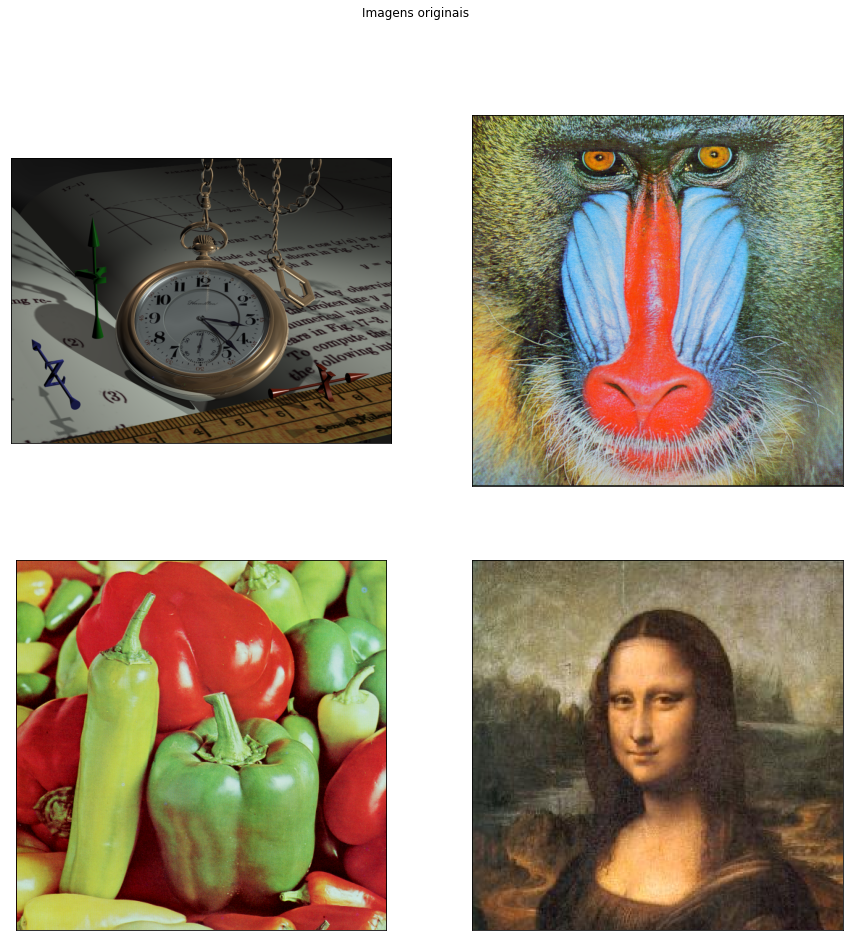

In [ ]:
imgs = loadImgs()
print(f"Acervo de imagens {imgs.keys()}")
custom_plot(imgs) 

## Carregando os métodos meio tom
Essa parte é responsável de carregar os métodos que serão utilizados. 

In [ ]:
methods = carregar_meio_tons()
print(f"Acervo dos métodos {methods.keys()}")

Acervo dos métodos dict_keys(['floyd_steinberg', 'stevenson_arce', 'burkes', 'sierra', 'stucki', 'jarvis_judice_ninke'])


## Análise
### Floyd Steinberg

Esse método é um método com granularidade que baseia na dispersão do erro. Ele basicamente pega as vizinhanças para cada ponto de imagem e avalia a cor mais próxima. Pega a diferença entre o valor da imagem e a cor da vizinhança depois repassa esse erros para pixel vizinho. Esse é considerado um método bom, mas lento. Como pôde observar é um método bastante interessante, teve bom resultado(é possível reconheecer a imagem) mesmo com aplicação do método, a imagem que mais é perceptivel a granularidade foi da monalisa e a imagem do relógio ficou um pouco escuro.

CPU times: user 1min 51s, sys: 37.9 ms, total: 1min 51s
Wall time: 1min 51s


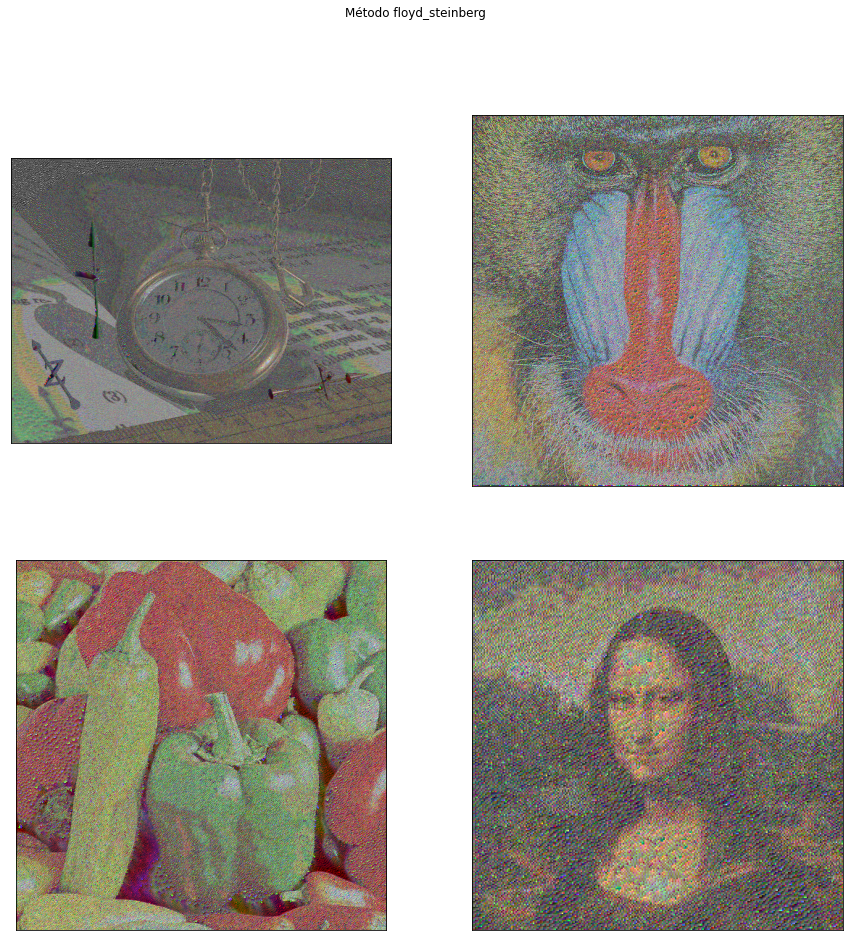

In [ ]:
%%time
custom_plot(imgs,{'floyd_steinberg':methods['floyd_steinberg']},flip=False,gray=False)

### Floyd Steinberg com flip
O método floyd steinberg é uma técnica bastante promissora não perdendo a informação da imagem. Mas para a funçÃo que foi implementada foi obtido um pequeno problema para aplicar esse método. Na literatura e vários exemplos apontam que o método da esquerda para direita e com direita para esquerda possui menor número de artefato, mas para esse trabalho foi encontrado vários artefatos provavelmente por causa do tipo de flip que foi feito a imagem não apresentou menor artefato.


CPU times: user 1min 55s, sys: 24.9 ms, total: 1min 55s
Wall time: 1min 55s


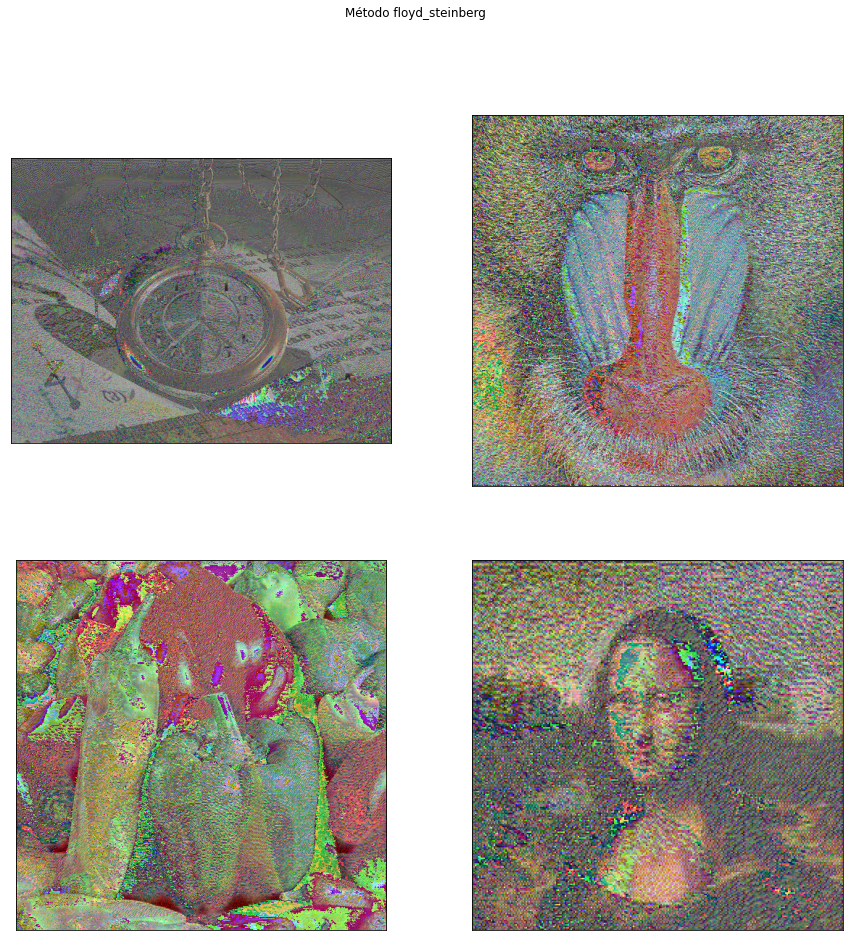

In [ ]:
%%time
custom_plot(imgs,{'floyd_steinberg':methods['floyd_steinberg']},flip=True,gray=False)

### Floyd Steinberg sem flip e gray
O método floyd steinberg é uma técnica bastante promissora não perdendo a informação da imagem. Para imagem sem flip e preto e branco foi notado o efeito da propagação do erro com maior detalhe. A imagem da monalisa ficou cheio de retalhos, assim como do relógio, mas foi notada maior grau de detalhamento que não foi percebido no colorido como essa mudança nos tons.

CPU times: user 36.6 s, sys: 15 ms, total: 36.6 s
Wall time: 36.7 s


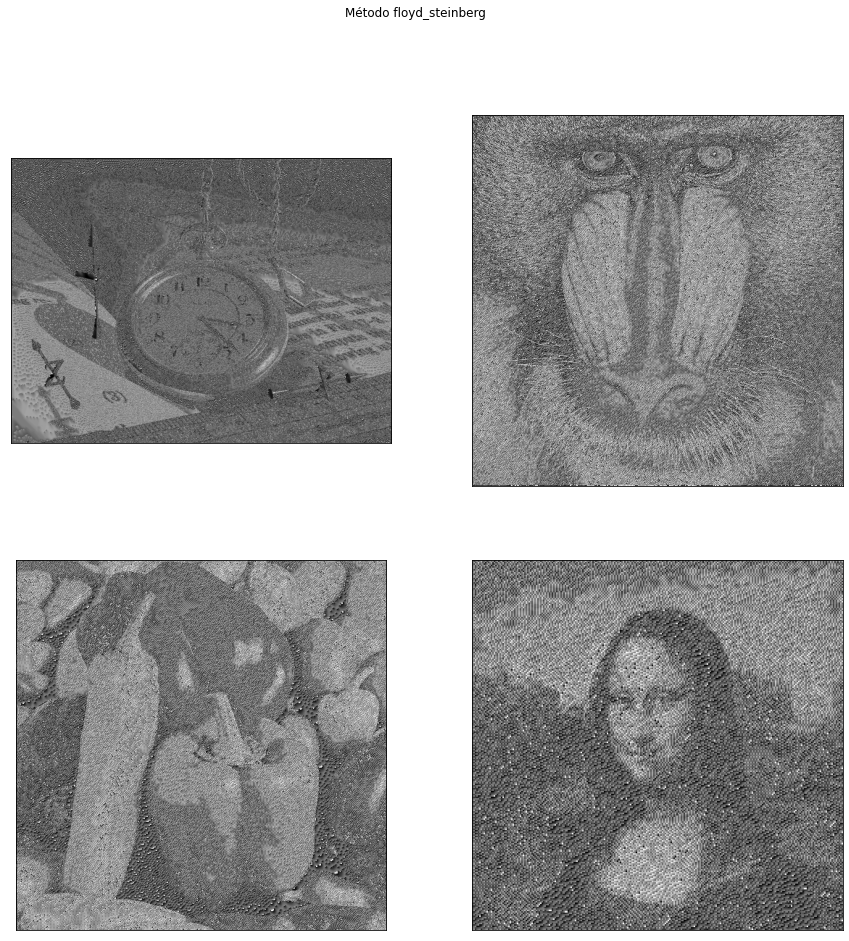

In [ ]:
%%time
custom_plot(imgs,{'floyd_steinberg':methods['floyd_steinberg']},flip=False,gray=True)

### Floyd Steinberg com flip e gray
O método floyd steinberg é uma técnica bastante promissora não perdendo a informação da imagem. Para o resultado com flip e preto e branco foi notado o efeito da propagação do erro com maior detalhe e percebeu que o método flip estava errado porque a imagem estava ficando com vários artefatos.

CPU times: user 43.5 s, sys: 9.97 ms, total: 43.5 s
Wall time: 43.6 s


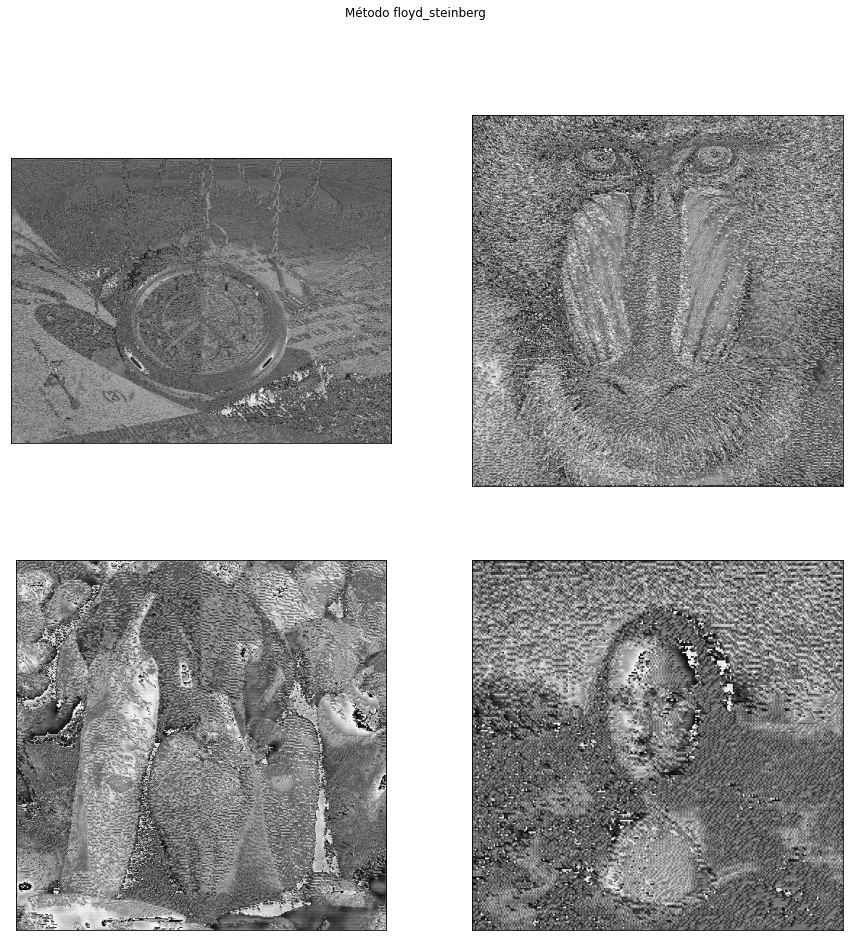

In [ ]:
%%time
custom_plot(imgs,{'floyd_steinberg':methods['floyd_steinberg']},flip=True,gray=True)

### Stevenson Arce
O método Stevenson Arce também aparentou em uma técnica bastante promissora não perdendo a informação da imagem. Diferente do primeiro método esse método parece mais desbotado que o primeiro e mais claro. Na pesquisa sobre o método  encontrou aplicações com hardware limitados para impressão de imagem. Mas atualmente as impressoras modernas utilizam outras técnicas mais sofisticados. As imagens resultantes tem uma textura parecido com algumas imagens encontradas em jornais.

CPU times: user 4min 42s, sys: 68 ms, total: 4min 42s
Wall time: 4min 42s


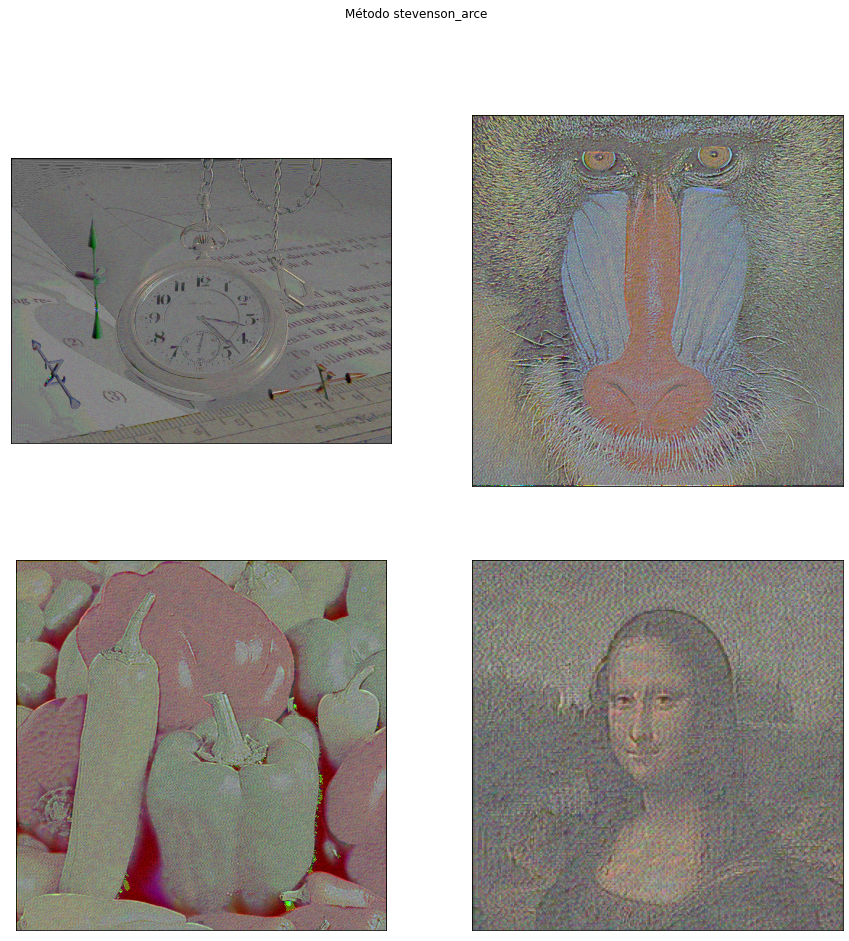

In [ ]:
%%time
custom_plot(imgs,{'stevenson_arce':methods['stevenson_arce']},flip=False,gray=False)

### Stevenson Arce com flip
O método Stevenson Arce também aparentou ser uma técnica bastante promissora não perdendo a informação da imagem. Assim como no método de Floyd, mas assim como descrevi anteriormente parece que existe algum problema no algoritmo por apresentar artefatos. 

CPU times: user 4min 50s, sys: 47 ms, total: 4min 50s
Wall time: 4min 50s


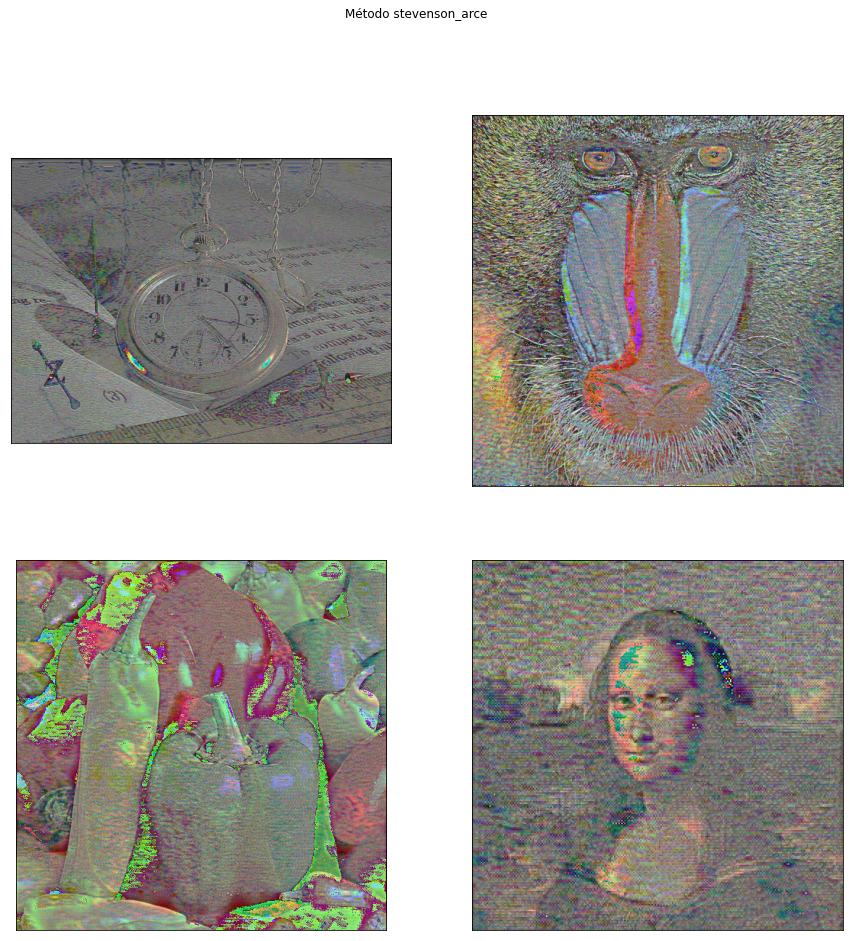

In [ ]:
%%time
custom_plot(imgs,{'stevenson_arce':methods['stevenson_arce']},flip=True,gray=False)

### Stevenson Arce gray sem flip
Assim como foi descrito no método acima o método de steven_arce aparentou bons resultados em preto e branco sem flip. A imagem da monalisa ficou melhor que coma técnica de Floyd com menos fragmentos na imagem ficando mais fácil de ver. Mas o tom desbotado fez com que o fundo ficasse mais irreconhecível.

CPU times: user 1min 34s, sys: 15 ms, total: 1min 34s
Wall time: 1min 34s


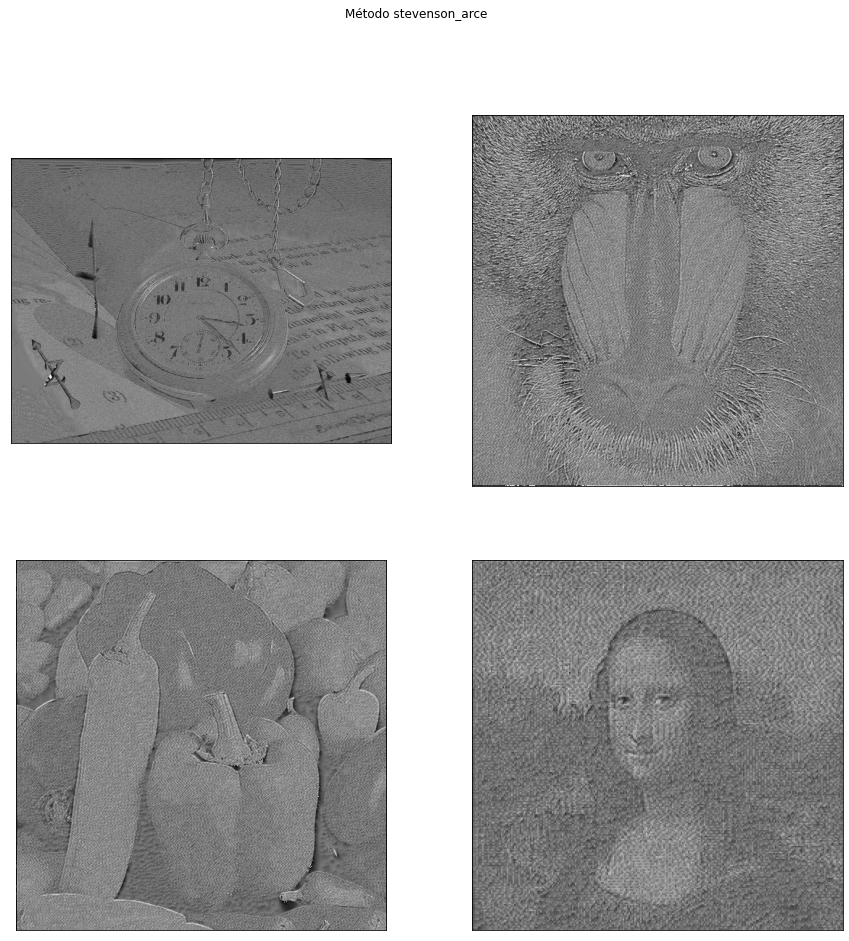

In [ ]:
%%time
custom_plot(imgs,{'stevenson_arce':methods['stevenson_arce']},flip=False,gray=True)

### Stevenson Arce gray com flip
O método de Stevenson Arce com flip como foi descrito acima está com alguma limitação em função de algum problema que encontrou no método de flip é possível notar que o fundo e imagem ficaram um pouco misturado não conseguindo ver muito bem os contornos de algumas parte da imagem.

CPU times: user 1min 38s, sys: 14 ms, total: 1min 38s
Wall time: 1min 38s


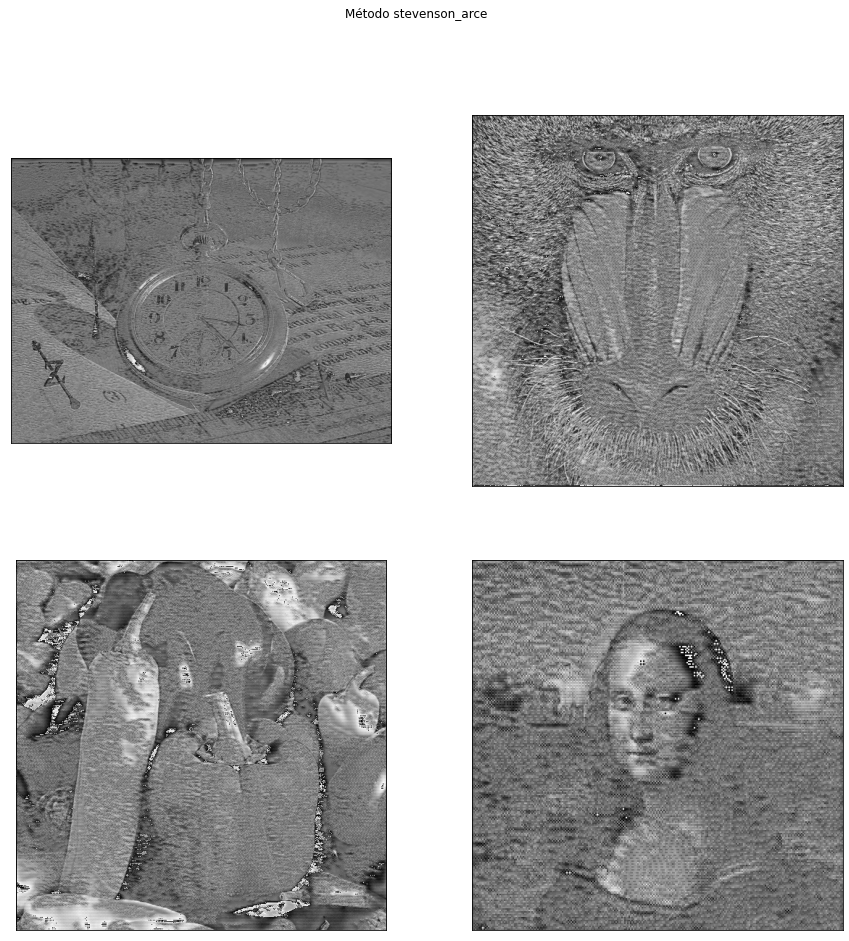

In [ ]:
%%time
custom_plot(imgs,{'stevenson_arce':methods['stevenson_arce']},flip=True,gray=True)

### Burkes
Assim como Floyd steinberg o algoritmo de Burkes é utilizado para difusão do erro. Diferente de floyd que  modifica menos pixels da vizinhança Burkes aplica o efeito em mais pixels e o efeito faz as imagens ficarem um pouco mais clara que método de floyd e o método de Burkes também apresentou uma textura parecida com método de Steveson só que com mais detalhes e aparentemente melhor que os dois métodos anteriores. O método de Steveson é um método que tem espaçamento maior e sua matriz também é maior.

CPU times: user 2min 50s, sys: 20 ms, total: 2min 50s
Wall time: 2min 50s


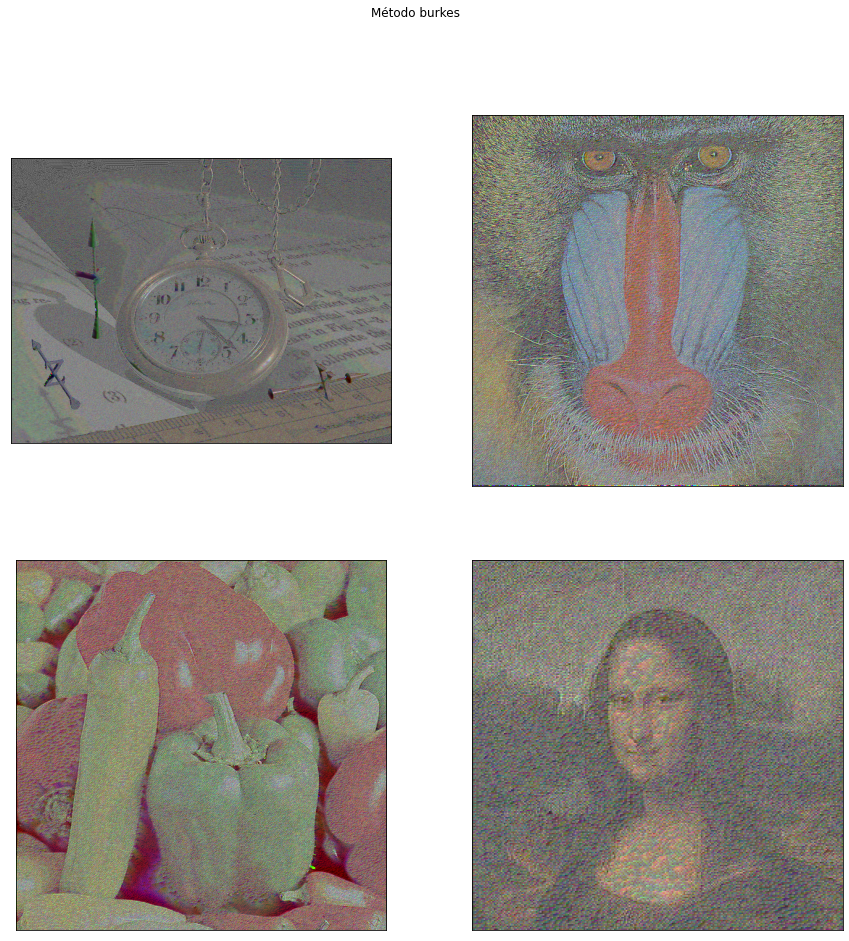

In [ ]:
%%time
custom_plot(imgs,{'burkes':methods['burkes']},flip=False,gray=False)

### Burkes sem flip e gray
Como foi descrito acima o método de burkes assim como método floyd parecem bastante promissores tanto para imagem colorida como preto e branco. Após aplicar a técnica observou que a imagem das pimentas e da monalisa ficaram com textura bastante marcante, mesmo assim ainda era possível identificar objeto das imagens já no caso do babuino e do relógio permaneceram boas de aparência sem muito ruido.  

CPU times: user 56.6 s, sys: 7 ms, total: 56.6 s
Wall time: 56.7 s


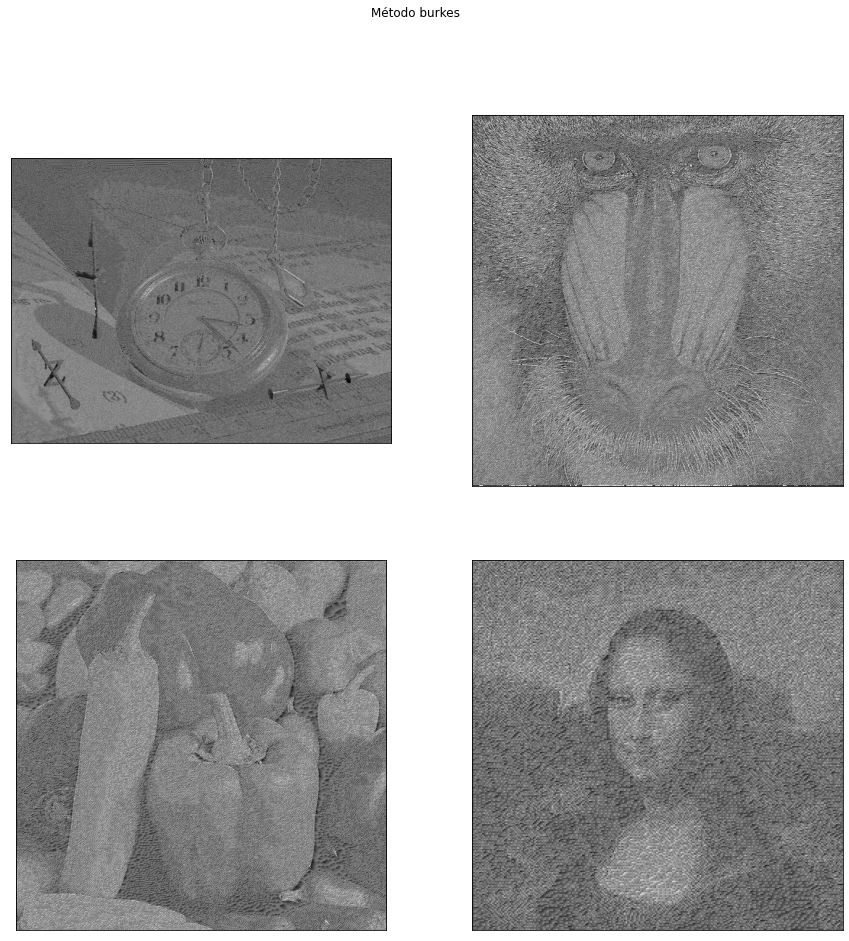

In [ ]:
%%time
custom_plot(imgs,{'burkes':methods['burkes']},flip=False,gray=True)

### Burkes com flip e sem gray
Esse método assim como os de cima apresentaram alguns ruído em função da forma como foi feito o flip. A imagem apresentou um efeito ondulado. é mais notado nas duas imagens, pimenta e monalisa.

CPU times: user 2min 59s, sys: 34 ms, total: 2min 59s
Wall time: 2min 59s


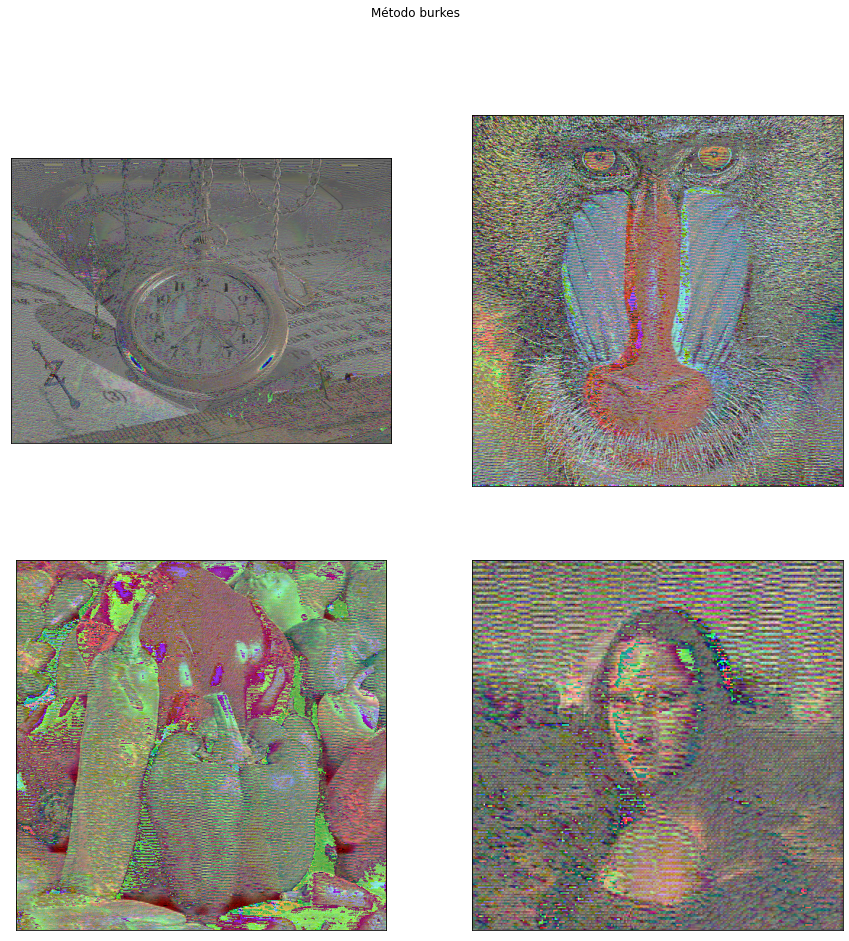

In [ ]:
%%time
custom_plot(imgs,{'burkes':methods['burkes']},flip=True,gray=False)

### Burkes com flip e gray
Esse método assim como os de cima apresentaram alguns ruído em função da forma como foi feito o flip. A imagem com flip e preto e branco deteriorou bastante em função do flip.

CPU times: user 59.1 s, sys: 21 ms, total: 59.1 s
Wall time: 59.2 s


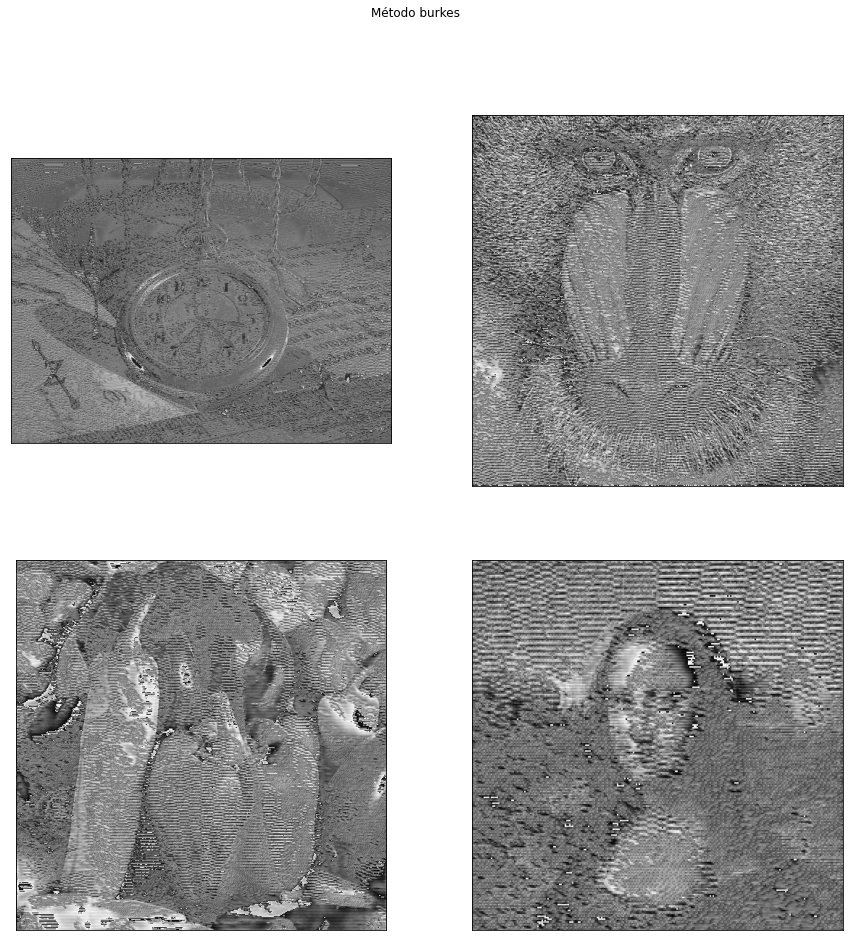

In [ ]:
%%time
custom_plot(imgs,{'burkes':methods['burkes']},flip=True,gray=True)

### Sierra
Método de Sierra parecido com os métodos anteiores, mas seu resultado apareceram bem mais desbotados que os metodos anteriores. E algumas apontam como um método rápido.

CPU times: user 3min 51s, sys: 42 ms, total: 3min 51s
Wall time: 3min 51s


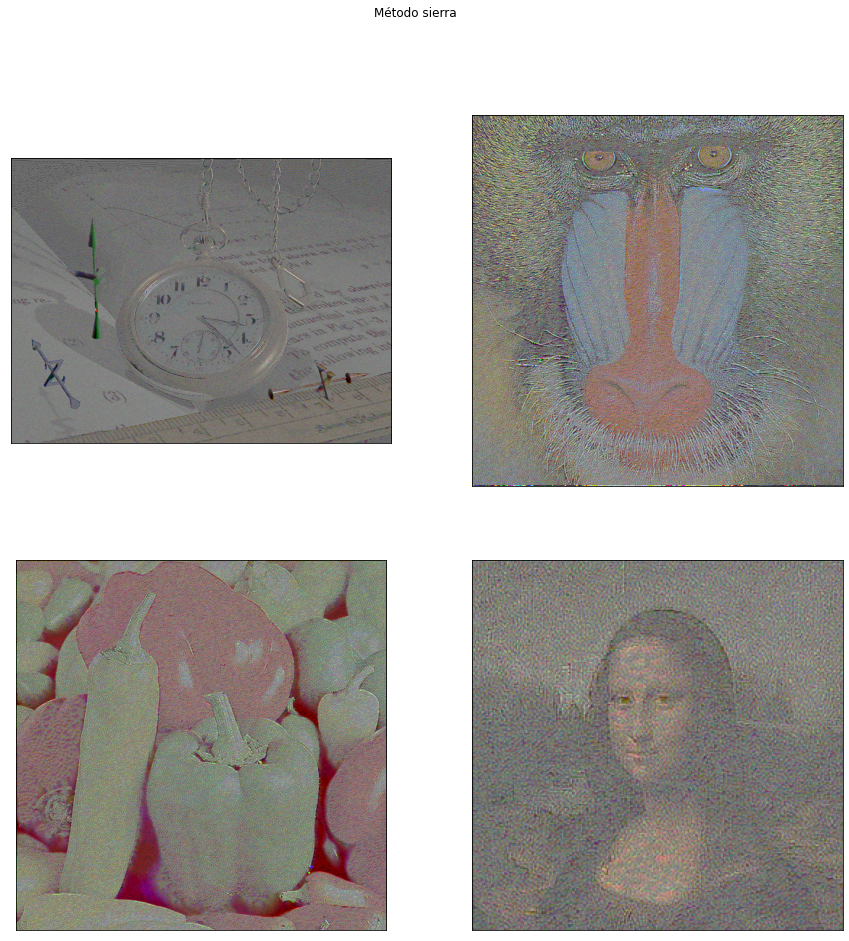

In [ ]:
%%time
custom_plot(imgs,{'sierra':methods['sierra']},flip=False,gray=False)

### Sierra com flip
Método de Sierra parecido com os métodos anteiores, mas seu resultado ficou bastante deteriorado em função do flip. 

CPU times: user 3min 58s, sys: 36 ms, total: 3min 58s
Wall time: 3min 58s


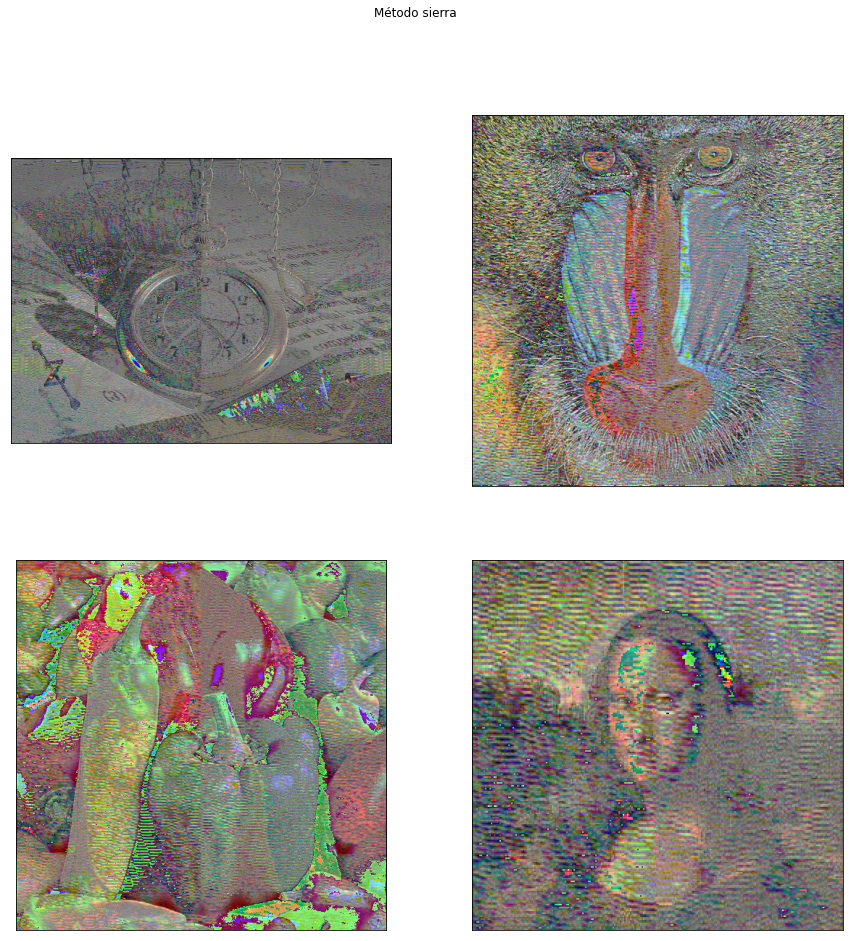

In [ ]:
%%time
custom_plot(imgs,{'sierra':methods['sierra']},flip=True,gray=False)

### Sierra sem flip e gray
O método de Sierra assim como pode ser visto acima desbotou bastante a imagem e sse efeito acabou notando mais na imagem preto e branco que os tons ficaram bem próximos

CPU times: user 1min 17s, sys: 12 ms, total: 1min 17s
Wall time: 1min 17s


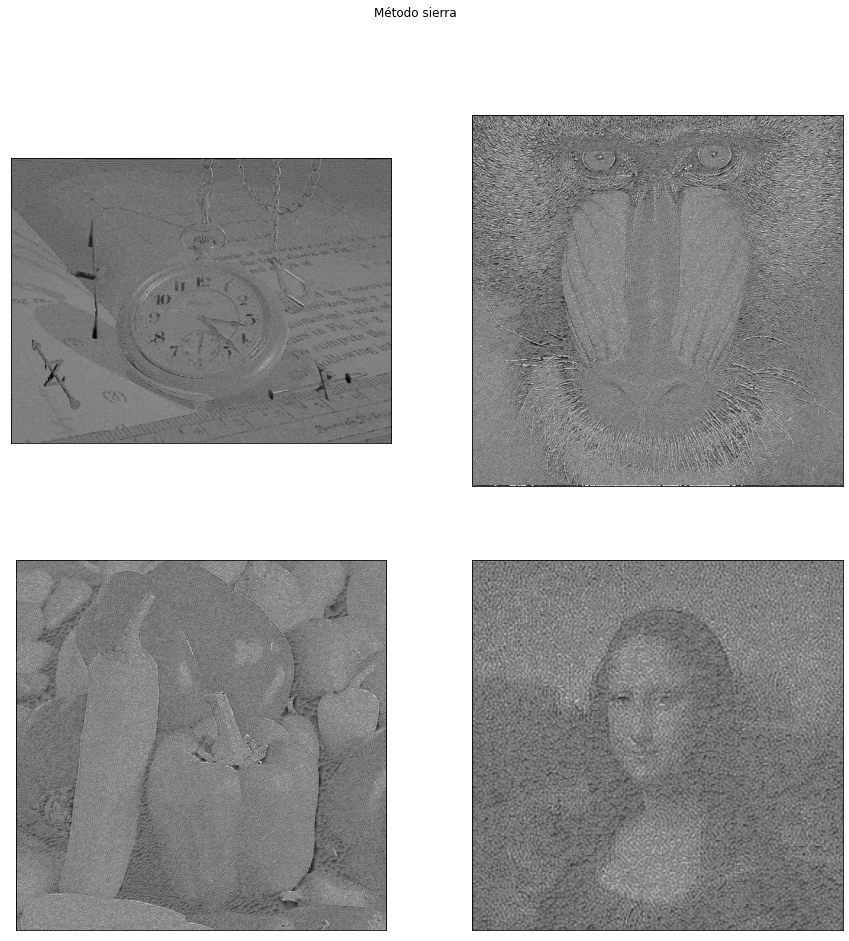

In [ ]:
%%time
custom_plot(imgs,{'sierra':methods['sierra']},flip=False,gray=True)

### Sierra com flip e gray
Para esse método com flip e gray também observou uma deterioração bem grande assim como a imagem colorida em função do flip.

CPU times: user 1min 20s, sys: 11 ms, total: 1min 20s
Wall time: 1min 20s


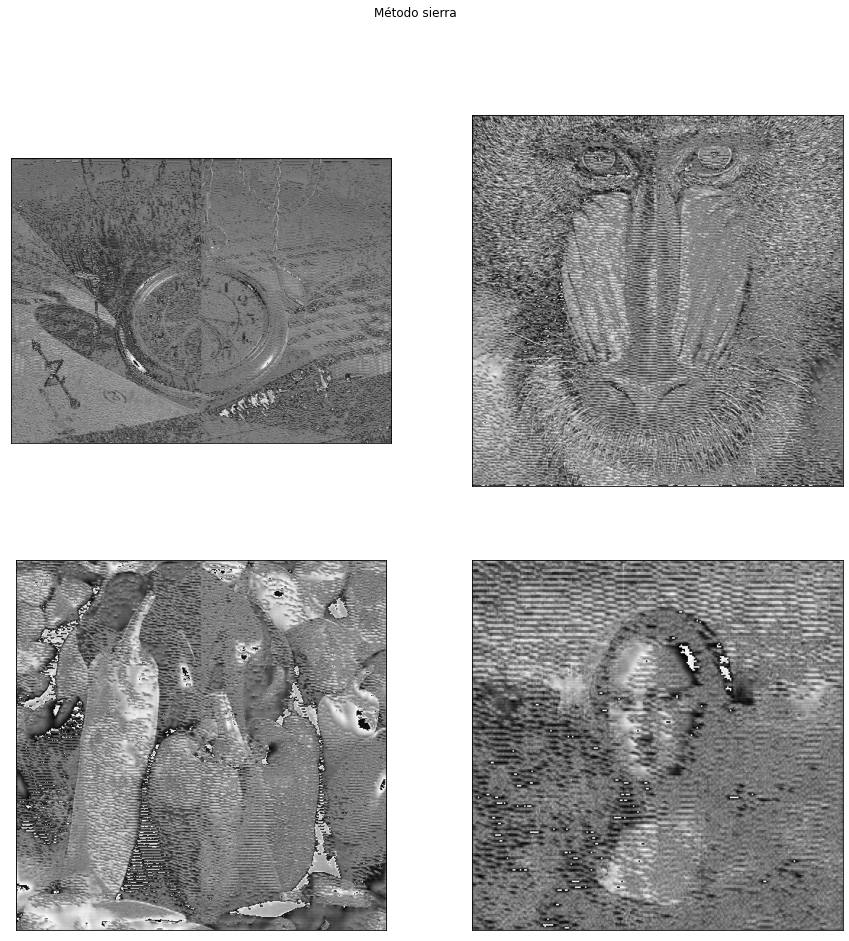

In [ ]:
%%time
custom_plot(imgs,{'sierra':methods['sierra']},flip=True,gray=True)

### Stucki
Método de stucki assim como os métodos acima possui 

CPU times: user 4min 32s, sys: 30 ms, total: 4min 32s
Wall time: 4min 32s


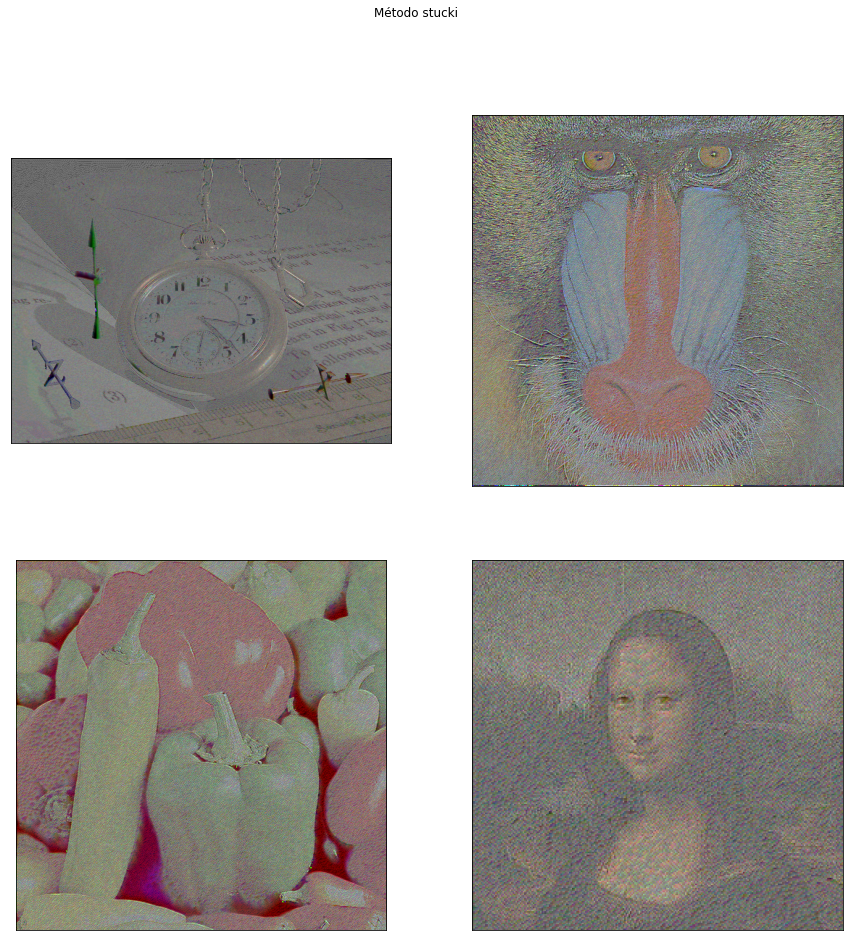

In [ ]:
%%time
custom_plot(imgs,{'stucki':methods['stucki']},flip=False,gray=False)

### Stucki com flip
O método de stucki com flip assim como os métodos anteriores com flip apresentam bastante degradação por causa do flip. As imagens da pimenta e da monalisa apresentaram uma quantidade de artefatos maior. Enquanto que as duas de baixos enfatizaram as partes reflexo.

CPU times: user 4min 32s, sys: 38 ms, total: 4min 32s
Wall time: 4min 32s


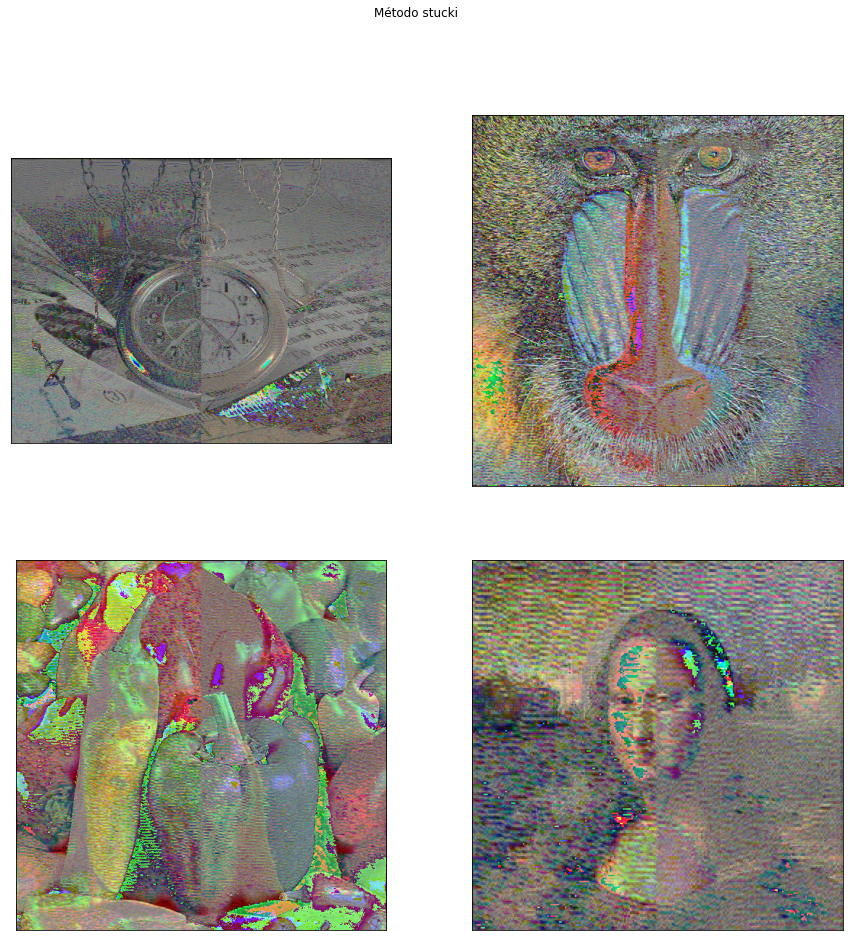

In [ ]:
%%time
custom_plot(imgs,{'stucki':methods['stucki']},flip=True,gray=False)

### Stucki com sem flip e gray
O método de stucki sem flip e gray apresentaram um resultado bastante similar com métodos acima con bia visibilidade , mas com um textura sobre a imagem as duas primeiras imagens é mais notório essa textura enquanto as duas de baixo não apresenta tanto esse efeito e se assemelha mais com os resultados anteriores.

CPU times: user 1min 29s, sys: 22 ms, total: 1min 29s
Wall time: 1min 29s


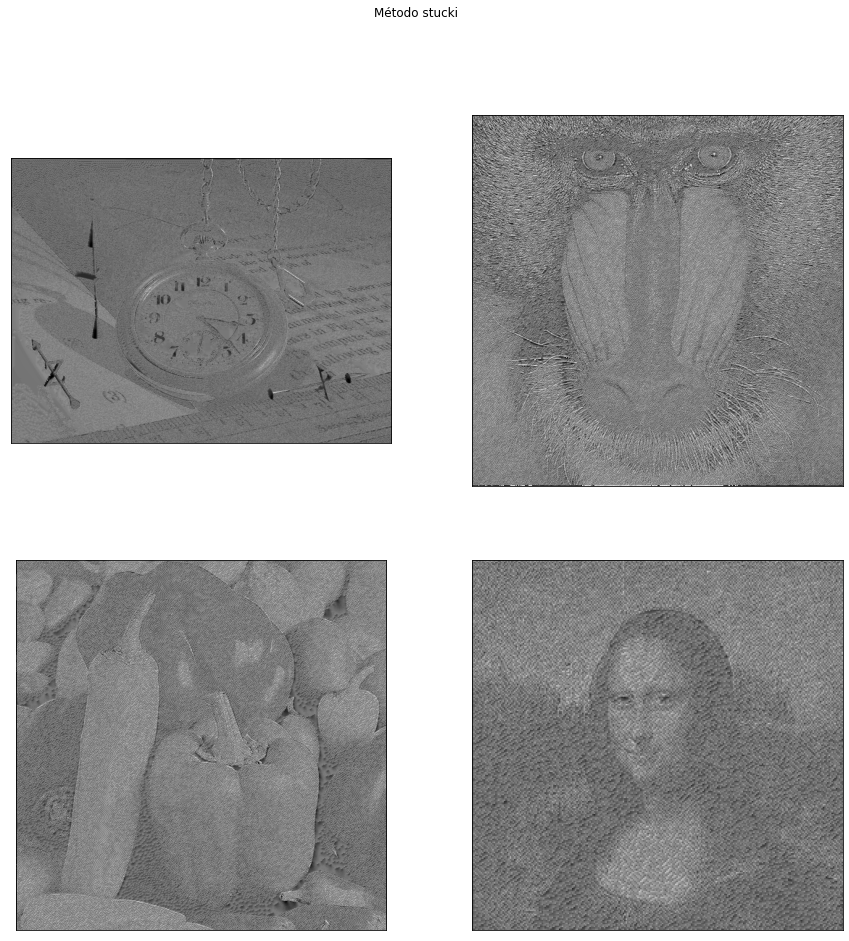

In [ ]:
%%time
custom_plot(imgs,{'stucki':methods['stucki']},flip=False,gray=True)

### Stucki com com flip e gray

CPU times: user 1min 31s, sys: 12 ms, total: 1min 31s
Wall time: 1min 31s


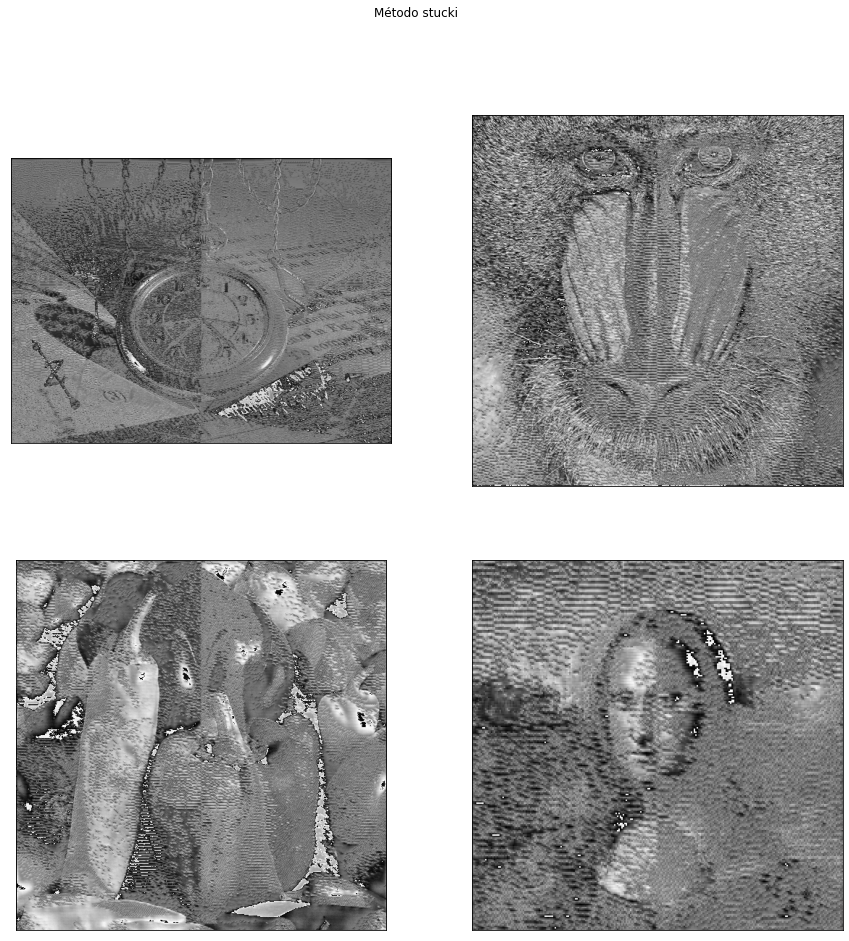

In [ ]:
%%time
custom_plot(imgs,{'stucki':methods['stucki']},flip=True,gray=True)

### Jarvis Judice Ninke
Método de Jarvis Judice Ninke também apresentou bom resultado, assim como os métodos acima ele deixou a imagem mais desbotada, na imagem da pimenta foi obsevado uma enfase maior na sombra entre as pimentas. A imagem da monaliza ficou bastante granulado, método sobre o relógio quase não percebeu-se muita diferença com relação aos métodos anteiores o método sobre o babuino também nÃo teve grandes mudanças, apenas que tinha ficado mais claro.

CPU times: user 4min 33s, sys: 45 ms, total: 4min 33s
Wall time: 4min 33s


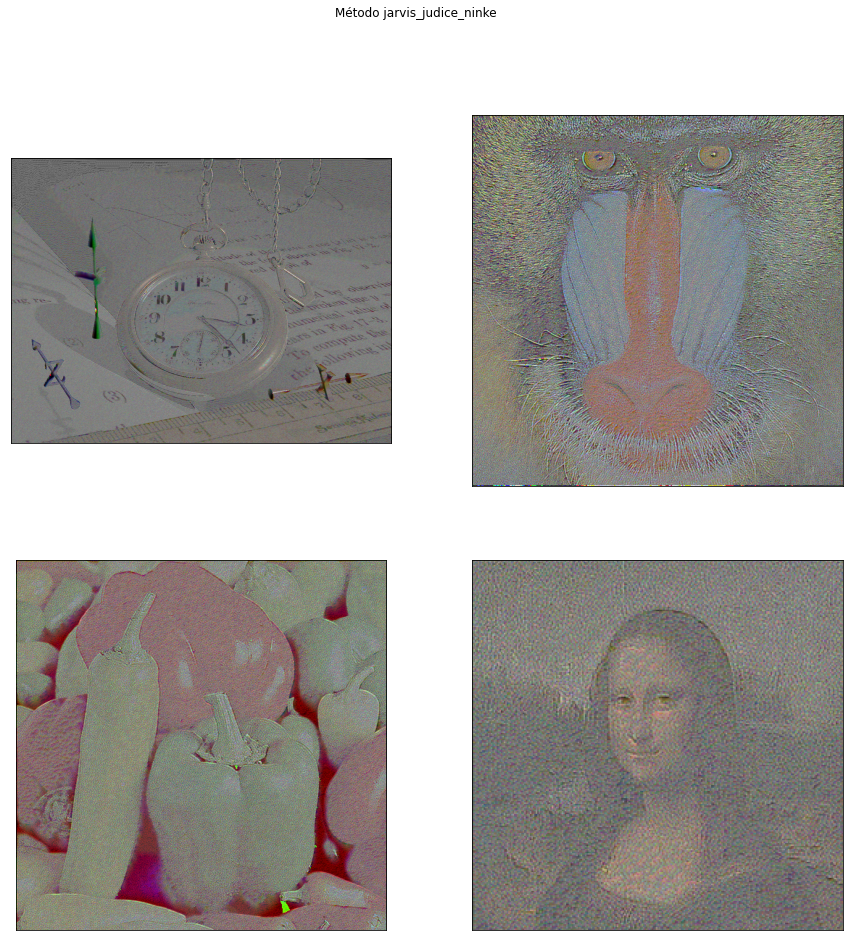

In [ ]:
%%time
custom_plot(imgs,{'jarvis_judice_ninke':methods['jarvis_judice_ninke']},flip=False,gray=False)

### Jarvis Judice Ninke com flip
O método de Jarvi judice Ninke com flip apresentou mesmo problemas dos métodos anteriores em função do flip, houve grande deteriorização em todas as imagens.

CPU times: user 4min 32s, sys: 30 ms, total: 4min 32s
Wall time: 4min 32s


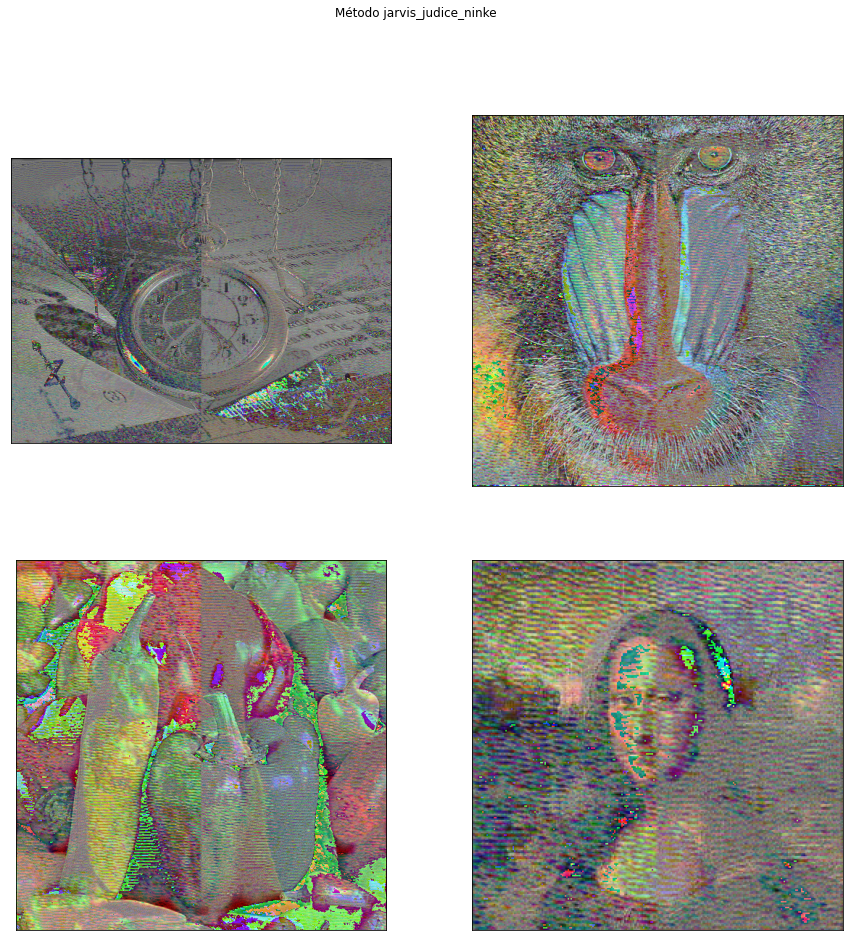

In [ ]:
%%time
custom_plot(imgs,{'jarvis_judice_ninke':methods['jarvis_judice_ninke']},flip=True,gray=False)

### Jarvis Judice Ninke com gray sem flip
Como esperado método Jarvis Judice Ninke com apresentou uma imagem com tons bastante próximo dos métodos anteiores, mas observou que houve um claremento bem grande nos tons cinza.

CPU times: user 1min 29s, sys: 19 ms, total: 1min 29s
Wall time: 1min 29s


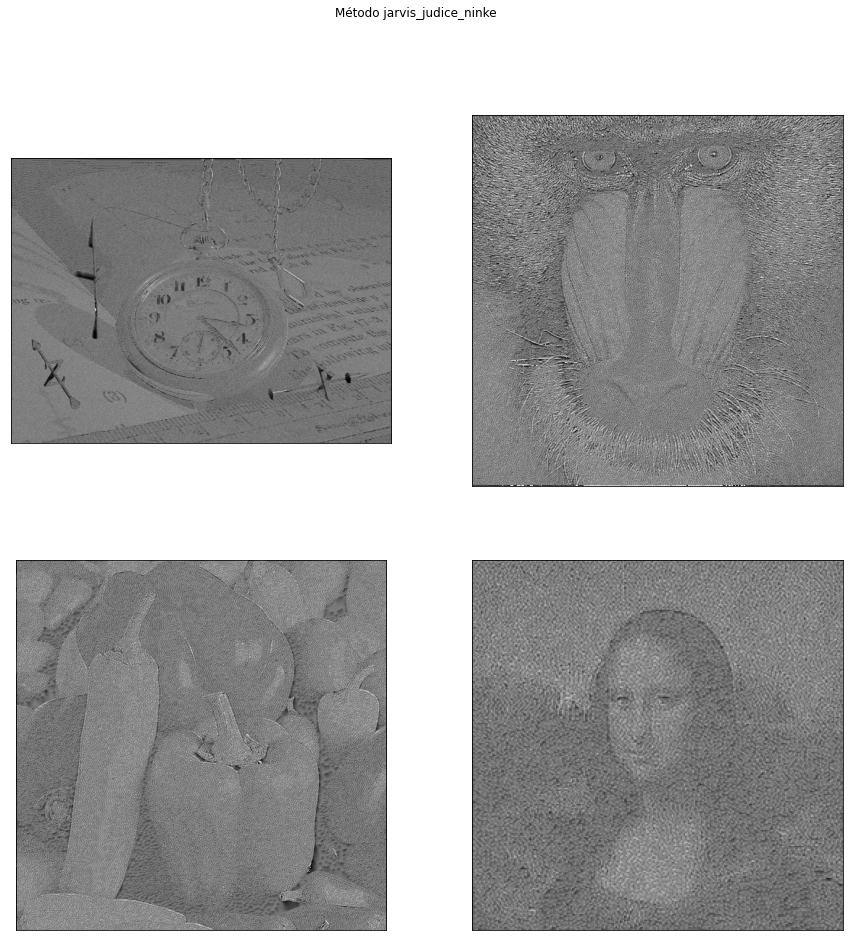

In [ ]:
%%time
custom_plot(imgs,{'jarvis_judice_ninke':methods['jarvis_judice_ninke']},flip=False,gray=True)

### Jarvis Judice Ninke com flip e gray
Assim como os métodos anteriores o método de Jarvis Judice Nink com flip e gray apresentaram deteriorização e acabou ficando bastante degradado. Vale reforçar que foi por causa do flip que não consegui encontrar bug até data da entrega.

CPU times: user 1min 31s, sys: 11 ms, total: 1min 31s
Wall time: 1min 31s


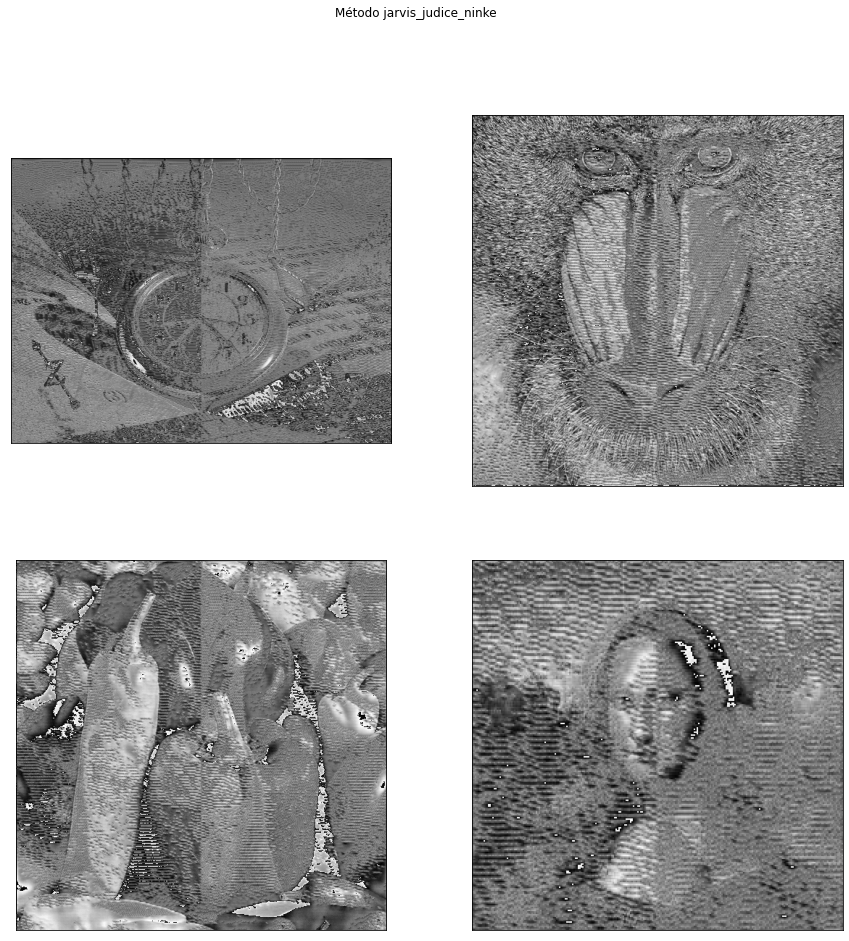

In [ ]:
%%time
custom_plot(imgs,{'jarvis_judice_ninke':methods['jarvis_judice_ninke']},flip=True,gray=True)

## Organizando imagens
Para organizar as imagens foi criado uma variável chamada mode para conseguir dinstinguir os tipos de arquivo. Depois disso foi interado por métodos e criado uma pasta por método e logo depois por modo, sem flip, com flip e com e sem gray.

In [ ]:
mode = ["sem_flip_gray","sem_flip","flip_gray","flip"]

In [ ]:
for i in methods:
  Path(f"results/{i}").mkdir(parents=True, exist_ok=True)
  for j in mode:
    Path(f"results/{i}/{j}/").mkdir(parents=True, exist_ok=True)

In [ ]:
for i in methods:
  for j in mode:
    for k in Path('.').glob(f"*{i}_{j}*"):
      k.rename(f"results/{i}/{j}/{k.name}")
for i in Path('.').glob(f"*.png"):
  i.rename(f"results/{i.name}")

### Baixando imagens
Por fim é criado um zip da pasta resultante e conteúdo é baixado.

In [ ]:
if 'google.colab' in sys.modules:
  !zip -r /content/projeto2.zip results/
  from google.colab import files
  files.download("/content/projeto2.zip")
else:
  print("Funcionalidade disponível apenas no colab")

  adding: results/ (stored 0%)
  adding: results/stucki/ (stored 0%)
  adding: results/stucki/sem_flip/ (stored 0%)
  adding: results/stucki/sem_flip/monalisa_stucki_sem_flip.png (deflated 0%)
  adding: results/stucki/sem_flip/peppers_stucki_sem_flip.png (deflated 0%)
  adding: results/stucki/sem_flip/watch_stucki_sem_flip.png (deflated 0%)
  adding: results/stucki/sem_flip/baboon_stucki_sem_flip.png (deflated 0%)
  adding: results/stucki/flip/ (stored 0%)
  adding: results/stucki/flip/monalisa_stucki_flip.png (deflated 0%)
  adding: results/stucki/flip/watch_stucki_flip.png (deflated 0%)
  adding: results/stucki/flip/peppers_stucki_flip.png (deflated 0%)
  adding: results/stucki/flip/baboon_stucki_flip.png (deflated 0%)
  adding: results/stucki/flip_gray/ (stored 0%)
  adding: results/stucki/flip_gray/baboon_stucki_flip_gray.png (deflated 0%)
  adding: results/stucki/flip_gray/peppers_stucki_flip_gray.png (deflated 0%)
  adding: results/stucki/flip_gray/monalisa_stucki_flip_gray.png (

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Análise de eficiência
Se o método procurado precisa ter um espaço reduzido então para esse experimento os melhores métodos foram Jarvis Judice Ninke, seguido por Sierra. Já se a preocupação é tempo de processamento os vencedores (não necessariamente é regra porque não foi feito um experimento sério medindo várias vezes) para este experimento o melhor resultado foi floyd steinberg e burkes que são justamente os dois maiores e tem ótimos resultados. Levando em consideração que a matriz de meio tons de Floyd steinberg seja menor de todos e a complexidade do algoritmo depende do tamanho da matriz de meio tons e do tamanho da matriz $M_{meiotom}*N_{meiotom}*Canal*M*N$ é bastante compreensível que tenha um tempo de execução menor tendo  $M_{meiotom} $ e $N_{meiotom}$ menor de todos.

In [ ]:
root_directory = Path('results')
for dir in root_directory.iterdir():
  if dir.is_dir():
    print(f"{dir.stem} {round(sum(f.stat().st_size for f in dir.glob('**/*') if f.is_file())/10**6,2)} Mbytes")

stucki 9.32 Mbytes
floyd_steinberg 10.7 Mbytes
burkes 9.7 Mbytes
jarvis_judice_ninke 8.93 Mbytes
stevenson_arce 9.59 Mbytes
sierra 9.04 Mbytes


## Conclusão

Então para este experimento concluiu que os métodos tem resultados visualmente bem próximos. É difícil avaliar qual método é melhor visualmente porque é bastante subjetivo e também depende muito de cada imagem e as imagens entre um método e outro tem apenas algumas características sutis dos outros métodos. 

O aprendizado e desafio desse trabalho foi  executar os métodos de meio tom e  generalizar essa técnica  usando o flip que não funcionou muito bem. No momento que começou o processo da generalização dos métodos em uma função para reduzir o código algum detalhe acabou faltando. A ideia é tentar arrumar isso. Porque deu para notar uma degradação nos resultados com flip e na literatura é citada que existe uma melhora na nitidez que não foi possível avaliar. 

Outros aprendizados foram com os casos de usos para estas técnincas. Aparentemente era bastante comum o uso dessas técnicas para reproduzir imagens em hardware no passado que não tinham condições de reproduzir a qualidade da imagem seja em um papel, projetor etc... Atualmente aconteceram várias evoluções, mas ainda é normal ver esse método em jogos de celulares e hardware mais limitado para reproduzir determinada imagem num equipamento. 


* https://www.visgraf.impa.br/Courses/ip00/proj/Dithering1/floyd_steinberg_dithering.html
* https://www.cyotek.com/blog/dithering-an-image-using-the-burkes-algorithm-in-csharp#:~:text=Burkes%20dithering,)%2C%20Burkes%20modifies%207%20pixels
* https://en.wikipedia.org/wiki/Dither